In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
# Load CSV files into dataframes
after_migrt_df = pd.read_csv('../data_pe/after_migrt_reward.csv')
before_migrt_df = pd.read_csv('../data_pe/before_migrt_reward.csv')

# Retain only 'fnid' and 'reward' columns from before_migrt_df
before_migrt_df = before_migrt_df[['coords', 'reward']].rename(columns={'reward': 'pre_reward'})

# Merge dataframes on 'fnid', keeping all rows and fill NaN values with appropriate defaults if needed
merged_df = pd.merge(after_migrt_df, before_migrt_df, on='coords', how='outer', suffixes=('_after', '_before'))
merged_df.fillna(0, inplace=True)

In [3]:
# Reorder columns to have 'before_mig_reward' as the second column
cols = merged_df.columns.tolist()
cols.insert(2, cols.pop(cols.index('pre_reward')))
merged_df = merged_df[cols]
merged_df.head(2)

,coords,fnid,pre_reward,20190707,20190708,20190709,20190710,20190711,20190712,20190713,...,20191222,20191223,20191224,20191225,20191226,20191227,20191228,20191229,20191230,20191231
0,"(113.8311136, 22.7939628)",55725.0,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.026104,-0.021766,-0.016366,-0.018589,-0.024987,-0.014753,-0.015864,-0.015290,-0.012375,-0.003722
1,"(113.8594877, 22.57118435)",19680.0,0.778622,0.72442,0.70562,0.694052,0.688291,0.708097,0.596952,0.537875,...,-0.331128,-0.327598,-0.321338,-0.327350,-0.336240,-0.327670,-0.332224,-0.328645,-0.323068,-0.315445


In [4]:
# merged_df.to_csv('../data_pe/all_traj_reward.csv',index=False)

# fnid only in origin or destination

In [4]:
one_df=pd.read_csv('../data/one_travel_chain.csv')
one_df['origin_point'] = list(zip(one_df['lambda_o'],one_df['phi_o']))
one_df['destination_point'] = list(zip(one_df['lambda_d'],one_df['phi_d']))
df_before_migrt = one_df[one_df['date'] < one_df['migrt']]
df_after_migrt = one_df[one_df['date']>one_df['migrt']]

In [5]:
before_migrt_set,after_migrt_set,all_fnid_set = set(),set(),set()

before_migrt_set.update(df_before_migrt['origin_point'].to_list())
before_migrt_set.update(df_before_migrt['destination_point'].tolist())

after_migrt_set.update(df_after_migrt['origin_point'].tolist())
after_migrt_set.update(df_after_migrt['destination_point'].tolist())

all_fnid_set.update(one_df['origin_point'].tolist())
all_fnid_set.update(one_df['destination_point'].tolist())

only_before = before_migrt_set - after_migrt_set
only_after = after_migrt_set - before_migrt_set
both_fnid = all_fnid_set - only_before - only_after

In [6]:
print(len(only_before),len(only_after),len(both_fnid))

170 194 10


In [7]:
def tuple_to_string(coord_tuple):
    return f"({coord_tuple[0]}, {coord_tuple[1]})"

only_before_str = [tuple_to_string(coord) for coord in only_before]
only_after_str = [tuple_to_string(coord) for coord in only_after]
both_fnid_str = [tuple_to_string(coord) for coord in both_fnid]

df_only_before = merged_df[merged_df['coords'].isin(only_before_str)]
df_only_after = merged_df[merged_df['coords'].isin(only_after_str)]
df_both_fnid = merged_df[merged_df['coords'].isin(both_fnid_str)]

In [8]:
import matplotlib.pyplot as plt

def plotTrends(df, rows_per_page=10):
    reward_columns = df.columns[2:]
    trends_data = df[reward_columns].transpose().pct_change().transpose()
    rewards_data = df[reward_columns]

    num_rows = df.shape[0]
    num_pages = (num_rows - 1) // rows_per_page + 1

    for page in range(num_pages):
        start_row = page * rows_per_page
        end_row = min(start_row + rows_per_page, num_rows)
        fig, axs = plt.subplots(end_row - start_row, 2, figsize=(20, 5 * (end_row - start_row)))
        
        # Adjust for the case when there's only one subplot row
        if end_row - start_row == 1:
            axs = [axs]

        for i in range(start_row, end_row):
            ax_trend, ax_reward = axs[i - start_row]

            # Plot trend
            ax_trend.plot(reward_columns, trends_data.iloc[i])
            ax_trend.set_ylabel("Percentage Change")
            ax_trend.set_xticks([]) 
            ax_trend.set_title(f"coords: {df.iloc[i]['coords']} - Trend")

            # Plot reward
            ax_reward.plot(reward_columns, rewards_data.iloc[i], label="Reward")
            ax_reward.scatter(reward_columns[0], rewards_data.iloc[i][0], color='red', s=50) 
            ax_reward.set_ylabel("Reward")
            ax_reward.set_xticks([]) 
            ax_reward.set_title(f"coords: {df.iloc[i]['coords']} - Reward")

        plt.tight_layout()
        plt.show()


C:\Users\liboy\AppData\Local\Temp\ipykernel_20972\981303447.py:31: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax_reward.scatter(reward_columns[0], rewards_data.iloc[i][0], color='red', s=50)


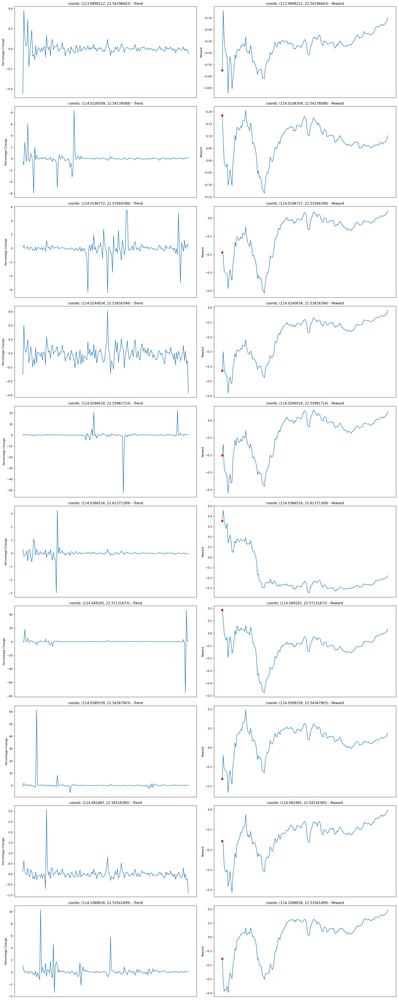

In [9]:
plotTrends(df_both_fnid)

C:\Users\liboy\AppData\Local\Temp\ipykernel_20972\981303447.py:31: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax_reward.scatter(reward_columns[0], rewards_data.iloc[i][0], color='red', s=50)


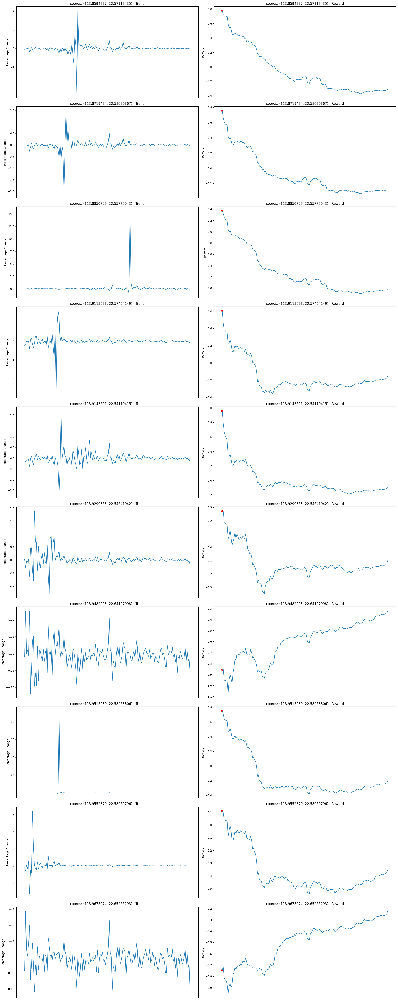

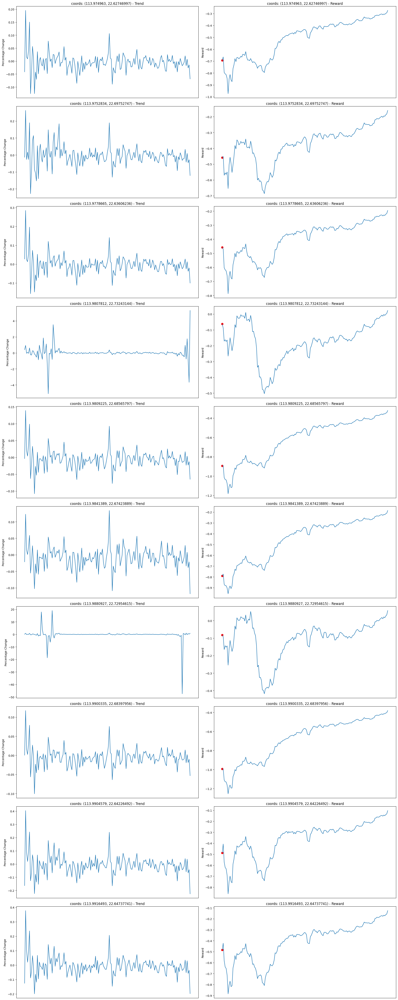

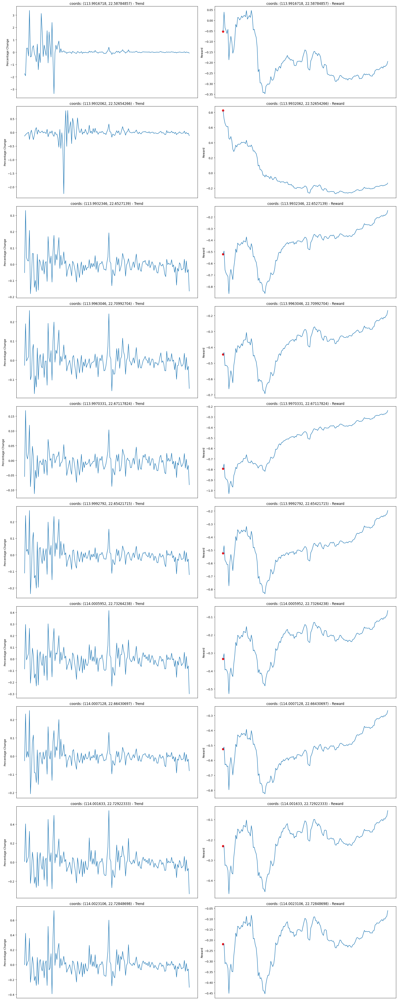

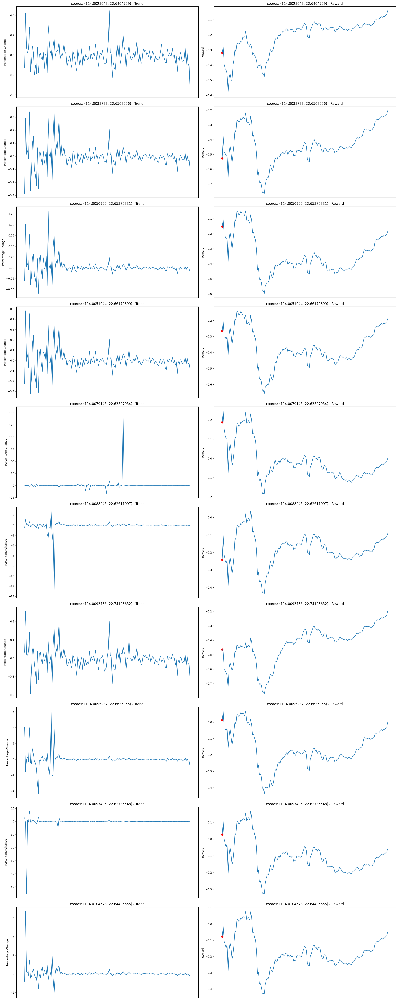

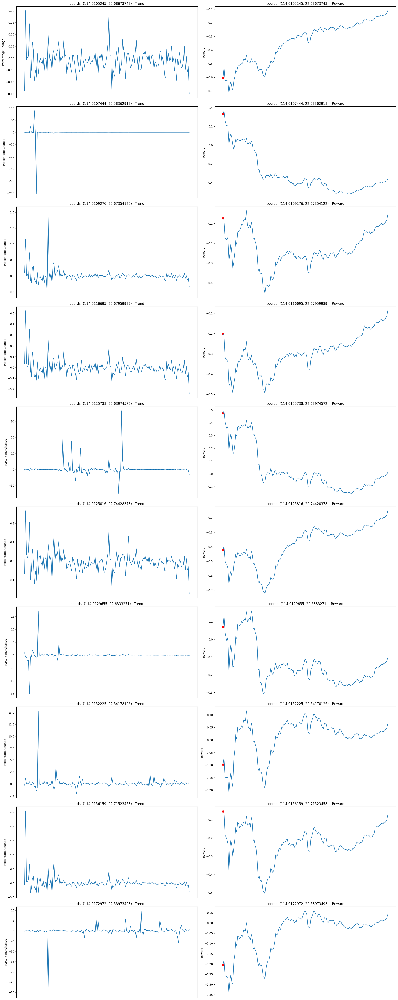

...

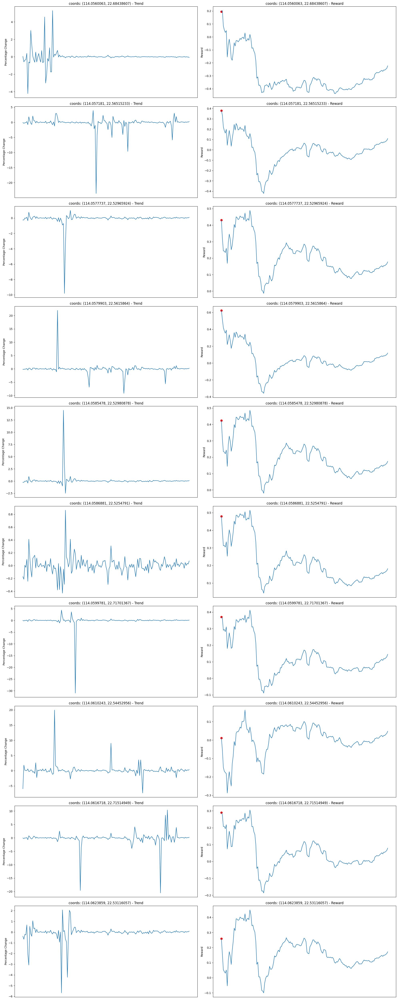

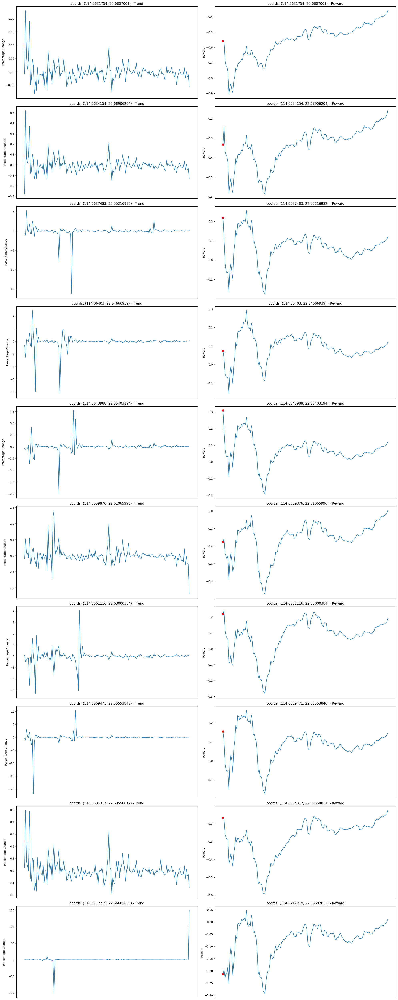

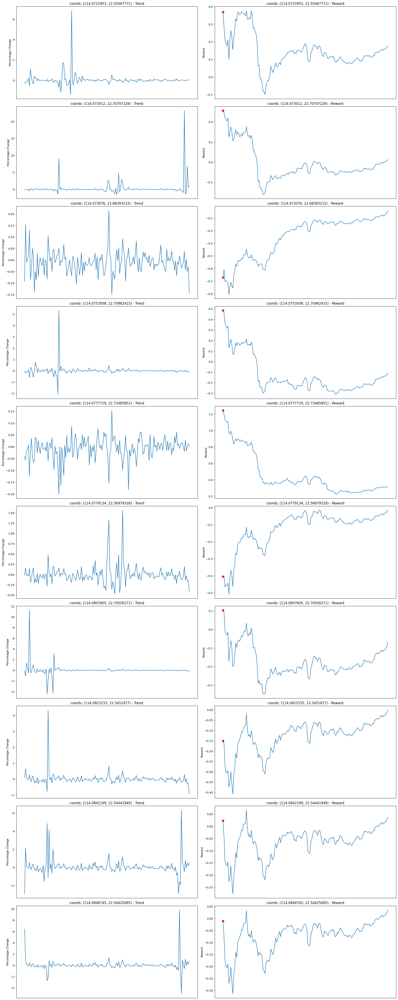

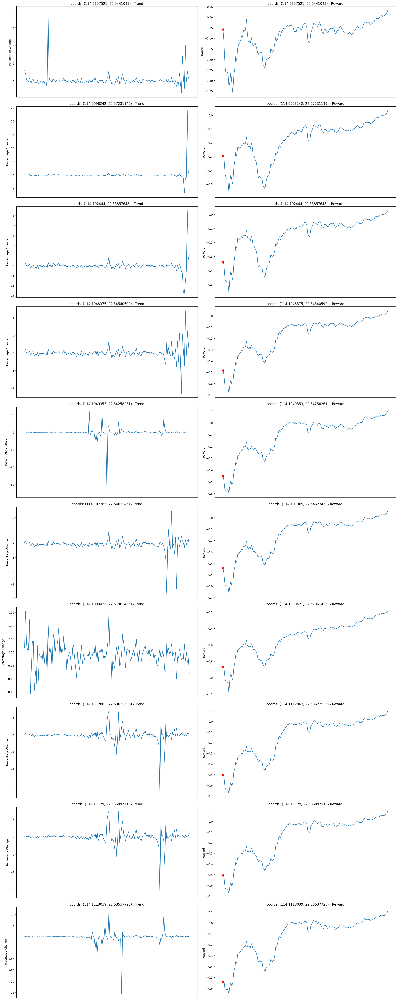

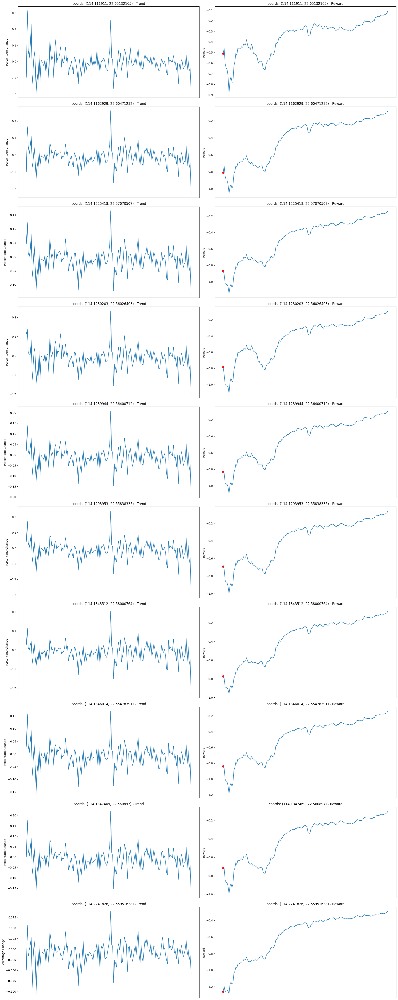

In [10]:
plotTrends(df_only_before)

C:\Users\liboy\AppData\Local\Temp\ipykernel_20972\981303447.py:31: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax_reward.scatter(reward_columns[0], rewards_data.iloc[i][0], color='red', s=50)


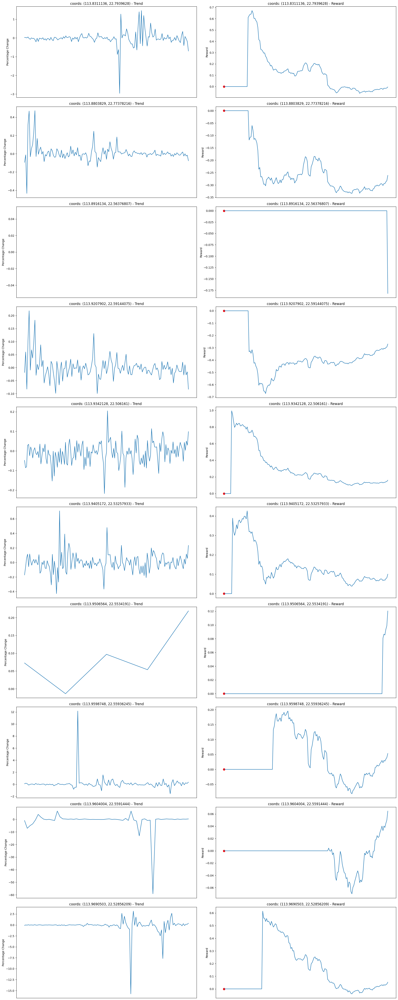

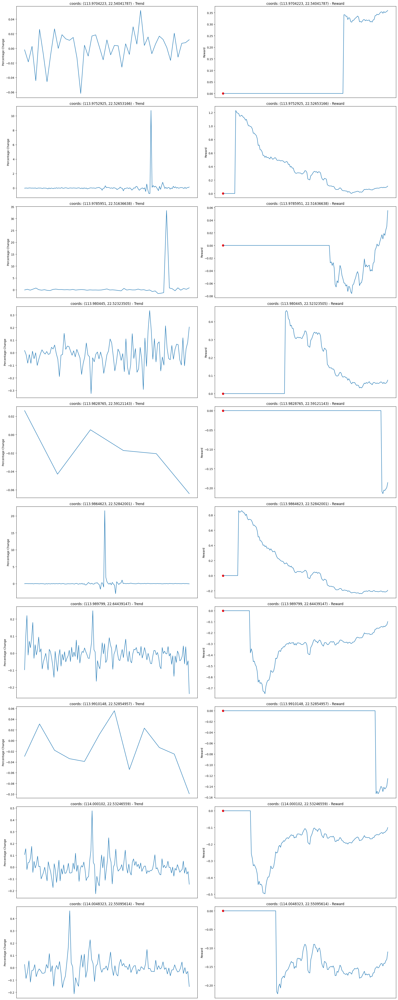

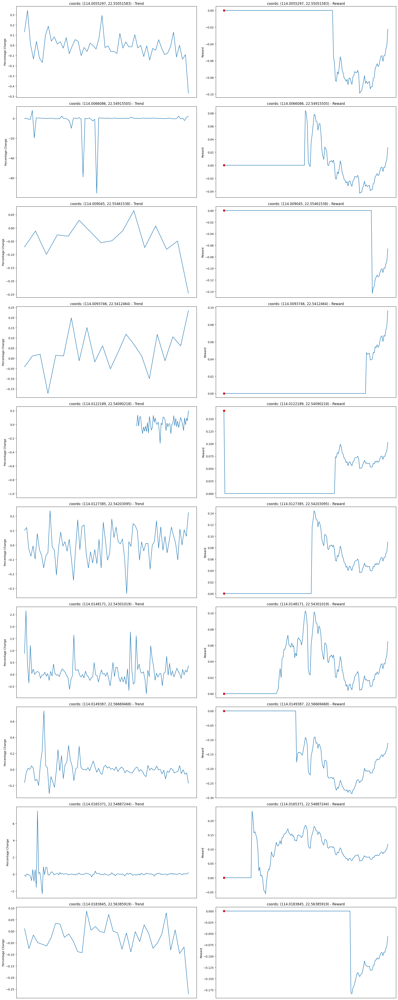

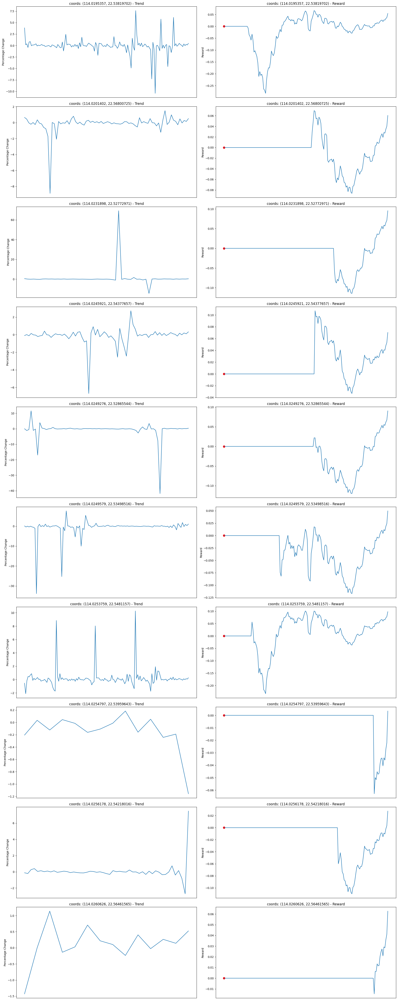

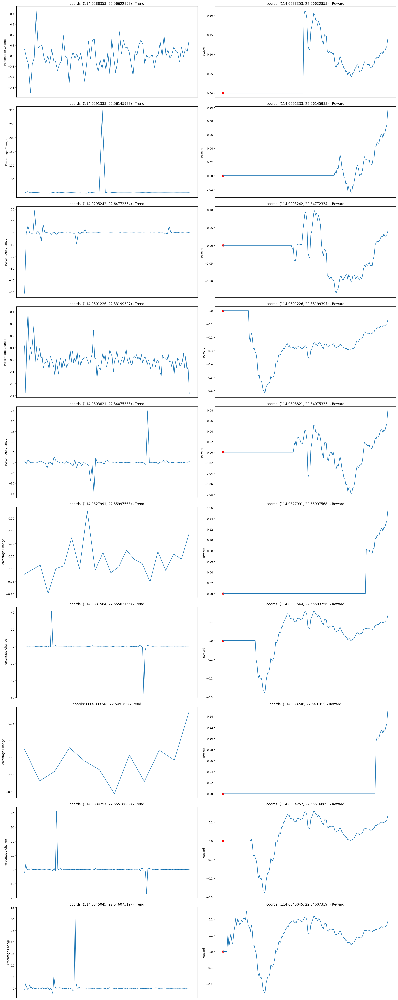

...

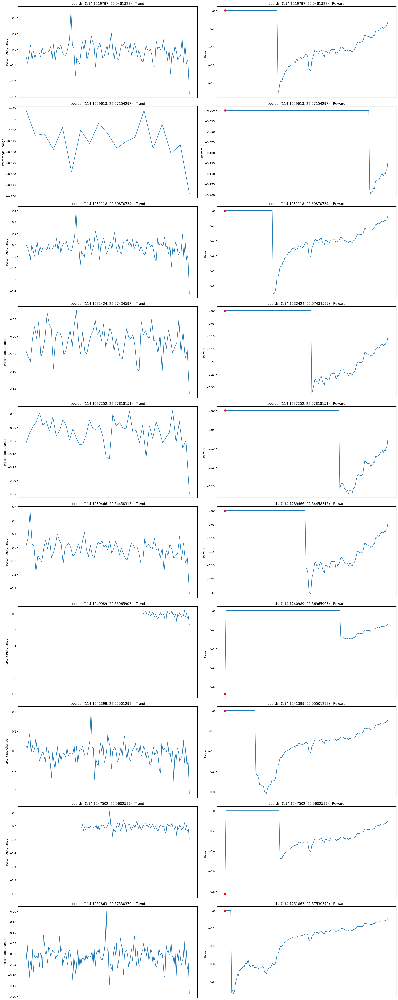

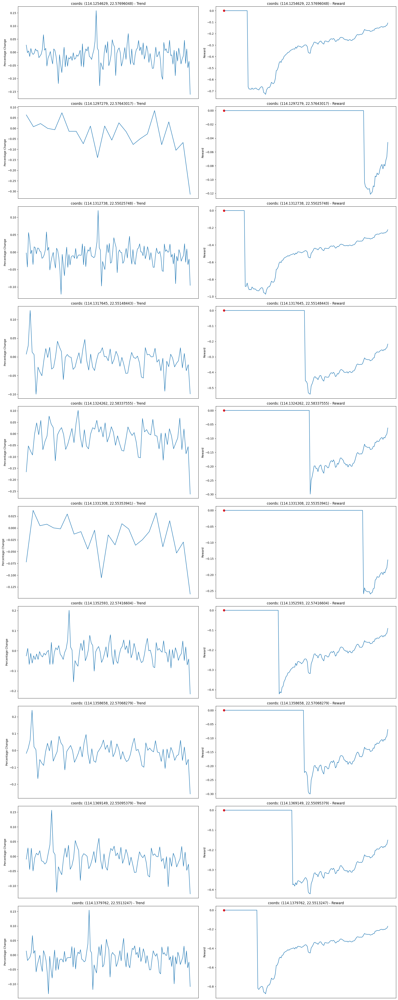

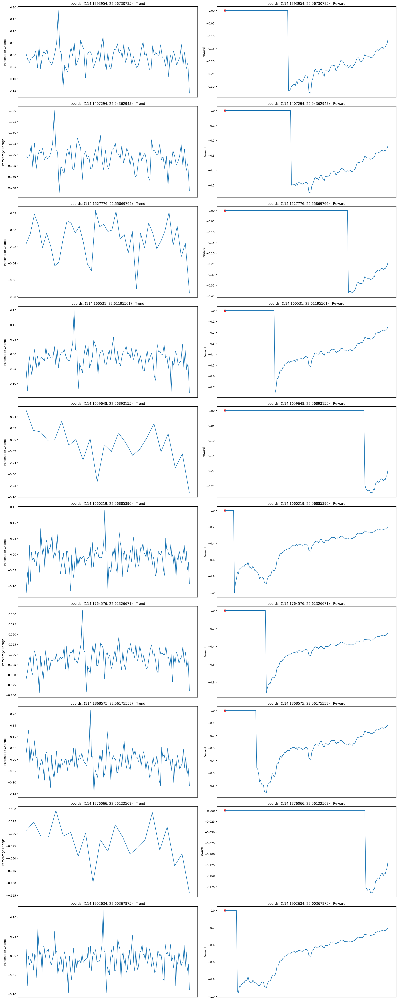

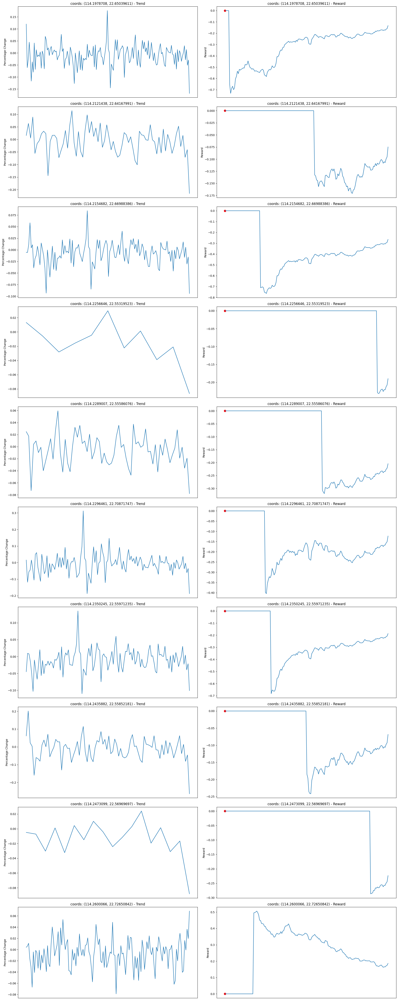

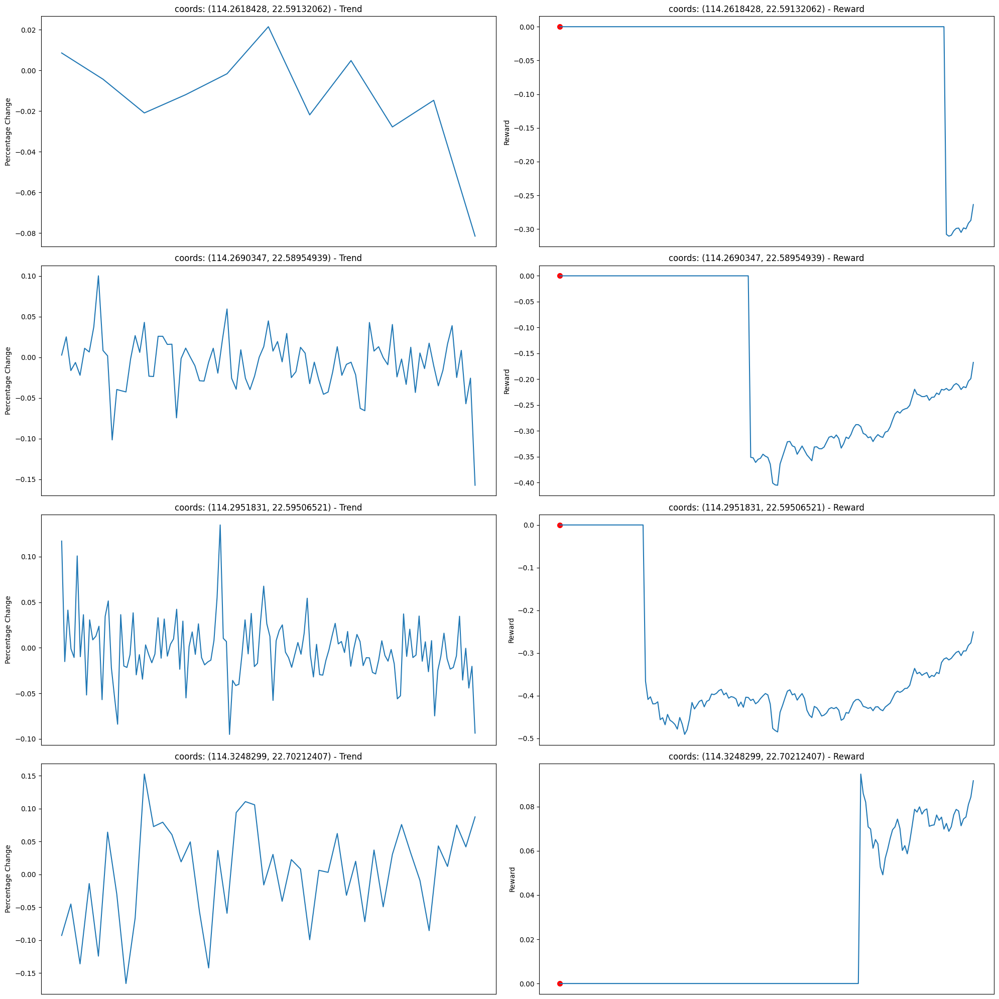

In [11]:
plotTrends(df_only_after)